# Functions

In [1]:
from functools import reduce
from operator import mul
import copy
import argparse
import numpy as np
import sys
import os
import json
import yaml
import time
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
import torch.nn.functional as F

from sys import argv
from os.path import join
from datetime import datetime
from tqdm import tqdm

import torch.nn as nn
import torch
from torch.utils.data import DataLoader
from typing import List, Tuple
from matplotlib.colors import colorConverter as cc

sys.path.append('/scratch1/zhenq/Source')

from ffdl.train_utils import ParallelDatasetSimpleProxy as DatasetProxy
from ffdl.unet import Recurrent_RUNet as Model

from AdaptiveAE import AdaptiveAutoEncoder3 as AdaptiveAutoEncoder
from Assimilate import ESMDA, simulate_ray_3d
from Assimilate import plot0, plot_mean_and_CI, LegendObject, Line2DLegendObject
from Assimilate import plot_data_posteriors, plot_comparisons, plot_iterative_updates
from Assimilate import plot_density, plot_mask, plot_fval, plot_obs, plot_real, plot_plume, plot_map
from Assimilate import RayPathMeasurementSimulatorModule as RayPathMeasurementSimulator
from Assimilate import CoarseningMeasurementSimulatorModule as CoarseningMeasurementSimulator
from Assimilate import OptimizationStage, Regularization, AdaptiveMask
from Assimilate import MultiResolutionLatentSelector
from Assimilate import filter_non_decreasing, convert_stage_x, save_configs
from Assimilate import multi_level_single_stage_optimization


# Set up device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)


def load_data(config_name = 'retrain_runet2Daa'):
    # Load Config
    config_path = join('./proxy', 'config', f'{config_name}.yaml') #/train_runet2Da.yaml
    with open(config_path) as f:
        config = yaml.load(f, Loader=yaml.loader.SafeLoader)

    # Load Data
    dir_to_dataset = config['dataset_config']['dir_to_dataset']
    batch_size = config['dataset_config']['batch_size'] # 4
    pred_length = config['dataset_config']['pred_length'] # 8
    year = list(range(16))
    timestep = [_ * 12 for _ in year]
    training_index = list(range(200))
    validate_index = list(range(500, 550))
    testing_index  = list(range(550, 600))

    # Training data loader
    training_set = DatasetProxy(training_index, dir_to_dataset, timestep, pred_length=len(timestep)-1)
    train_loader = DataLoader(training_set, batch_size=batch_size, shuffle=True)

    # Validation data loader
    validate_set = DatasetProxy(validate_index, dir_to_dataset, timestep, pred_length=len(timestep)-1)
    valid_loader = DataLoader(validate_set, batch_size=1, shuffle=False)

    # Testing data loader
    testing_set = DatasetProxy(testing_index, dir_to_dataset, timestep, pred_length=len(timestep)-1)
    test_loader = DataLoader(testing_set, batch_size=1, shuffle=False)
    data_loader = {'train': train_loader, 'valid': valid_loader, 'test': test_loader}

    return data_loader


def load_predictive_model(config_name = 'retrain_runet2Daa'):
    # Load Config
    config_path = join('./proxy', 'config', f'{config_name}.yaml') #/train_runet2Da.yaml
    checkpoint_path = join('./proxy', 'checkpoint', config_name, 'checkpoint.pt')
    with open(config_path) as f:
        config = yaml.load(f, Loader=yaml.loader.SafeLoader)

    # Build Model
    model = Model(**config['model_config']).to(device)
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Proxy: Numer of trainable parameter: {trainable_params/1e6 :.4f} million")

    # Load Model
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])

    return model
    

def load_autoencoder(config_name = 'autoencoder'):
    # Config parser 
    config_path = join('./autoencoder', 'config', f'{config_name}.yaml') # /scratch1/zhenq/AramcoProject/1.Parameterization/Autoencoder/config
    with open(config_path) as f:
        config = yaml.load(f, Loader=yaml.loader.SafeLoader)

    model_config = config['model_config']
    if model_config.get('norm') == 'group':
        model_config['norm'] = ("group", {"num_groups": model_config.get('num_groups', 2)})
    if model_config.get('act') == 'prelu':
        model_config['act'] = ("prelu", {"init": 0.2})

    train_config = config['train_config']
    train_config['gradient_clip_val'] = None if train_config['gradient_clip'] is False else train_config['gradient_clip_val']

    disc_config = config['disc_config']

    # Build Model
    Model = AdaptiveAutoEncoder
    model = Model(units=model_config.get('units'), model_config=model_config).to(device)
    model_trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)/1e6
    print(f'Autoencoder: Number of trainable parameters: {model_trainable_params} M')
    
    # Load Model
    path_to_ckpt = join('./autoencoder', 'checkpoint') 
    # root_to_model = '/scratch1/zhenq/AramcoProject/1.Parameterization/Model'
    # path_to_ckpt = join(root_to_model, 'Grid_512_128_20250120/autoencoder_base_large/AE4.0M-Level_2_3_4_5-Pdim_1024_256_64_16-Sdim_32_16_8_4-Ldim_1-l1_Percept-X128Y512')
    checkpoint_path = join(path_to_ckpt, f'{config_name}.pt')
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['autoencoder_state_dict'])
    return model


def plot_plume2(s_ref, s_ini, s_opt, titles, mask=None, dpi=400):
    """
    Plots the reference, initial, and post-optimization models.

    Args:
        stage: The optimization stage object (should contain `s_ref` and `sim_history`).
        dpi (int, optional): Resolution of the plot. Default is 400.
    """
    
    # Use gridspec to allocate space for colorbars
    fig = plt.figure(figsize=(8, 2), dpi=dpi)
    spec = gridspec.GridSpec(nrows=2, ncols=4, width_ratios=[1, 1, 1, 0.05])  # 预留 colorbar 位置

    axes = np.empty((2, 3), dtype=object)

    # Reference model
    axes[0, 0] = fig.add_subplot(spec[0, 0])
    im1 = axes[0, 0].imshow(s_ref, cmap='jet', vmin=0, vmax=1)
    if mask is not None:
        axes[0, 0].imshow(mask, cmap='Greys', vmin=0, vmax=1, alpha=0.4)
        # im1 = axes[0, 0].imshow(mask, cmap='Greys', vmin=0, vmax=1)
    axes[0, 0].set_title(titles[0])

    axes[1, 0] = fig.add_subplot(spec[1, 0])
    axes[1, 0].axis('off')
    
    # Initial model (first iteration)
    axes[0, 1] = fig.add_subplot(spec[0, 1])
    im2 = axes[0, 1].imshow(s_ini, cmap='jet', vmin=0, vmax=1)
    if mask is not None:
        axes[0, 1].imshow(mask, cmap='Greys', vmin=0, vmax=1, alpha=0.4)
    axes[0, 1].set_title(titles[1])

    axes[1, 1] = fig.add_subplot(spec[1, 1])
    im3 = axes[1, 1].imshow(s_ref - s_ini, cmap='seismic', vmin=-1, vmax=1)

    # Final model (last iteration)
    axes[0, 2] = fig.add_subplot(spec[0, 2])
    im4 = axes[0, 2].imshow(s_opt, cmap='jet', vmin=0, vmax=1)
    if mask is not None:
        axes[0, 2].imshow(mask, cmap='Greys', vmin=0, vmax=1, alpha=0.4)
    axes[0, 2].set_title(titles[2])

    axes[1, 2] = fig.add_subplot(spec[1, 2])
    im5 = axes[1, 2].imshow(s_ref - s_opt, cmap='seismic', vmin=-1, vmax=1)

    # Remove ticks for better visualization
    for ax in axes.flatten():
        ax.set_xticks([])
        ax.set_yticks([])

    # Colorbar for the first row (jet colormap)
    cax1 = fig.add_subplot(spec[0, 3])  # Allocated space for the colorbar
    cbar1 = fig.colorbar(im1, cax=cax1, ax=axes[0, :], ticks=[0.0, 0.5, 1.0])

    # Colorbar for the second row (seismic colormap)
    cax2 = fig.add_subplot(spec[1, 3])  # Allocated space for the colorbar
    cbar2 = fig.colorbar(im3, cax=cax2, ax=axes[1, :], ticks=[-1.0, 0.0, 1.0])

    plt.tight_layout()
    plt.show()

    
def plot_fval2(f_stages_dict, logy_scale=False, dpi=400):
    """
    Plots the optimization history for an arbitrary number of stages.

    Args:
        *f_stages_dict: Variable number of optimization objects.
        logy_scale (bool, optional): If True, use logarithmic scale for y-axis.
        dpi (int, optional): Resolution of the plot. Default is 400.
    """
    line_kwargs = {'ls': '-', 'lw': 2, 'alpha': 0.9}
    colors = ['royalblue', 'darkorange', 'forestgreen', 'crimson', 'purple', 'goldenrod', 'deepskyblue']
    
    # Ensure there are enough colors for the stages
    num_stages = len(f_stages_dict)
    if num_stages > len(colors):
        colors = cm.get_cmap('tab10', num_stages).colors  # Generate more colors if needed

    # Define iteration numbers
    init_iter = 0
    iter_ranges = []
    f_values = []
    key_vals = []

    for key, f_val in f_stages_dict.items():
        f_values.append(f_val)
        key_vals.append(key)
        iter_range = np.arange(init_iter, init_iter + len(f_values[-1]))
        iter_ranges.append(iter_range)
        init_iter += len(f_values[-1]) - 1 # Update starting point for next stage

    # Plot figure
    plt.subplots(figsize=(5, 3), dpi=dpi)

    for i, (iter_range, key, f_val) in enumerate(zip(iter_ranges, key_vals, f_values)):
        plt.plot(iter_range, f_val, color=colors[i], label=key, **line_kwargs)

    # Draw vertical dashed lines at the end of each stage except the last one
    for i in range(len(iter_ranges) - 1):
        plt.axvline(x=iter_ranges[i][-1], color='black', linestyle='--', lw=1.5, alpha=0.2)

    # Formatting
    plt.grid(lw=0.2, alpha=0.5)
    
    if logy_scale:
        plt.yscale('log')
        plt.xscale('log')

    plt.xlabel('Iteration', fontsize=12)
    plt.ylabel('Objective Function Value', fontsize=12)
    plt.legend(loc="best", fontsize=10)  # Automatically place legend in best position
    plt.show()

    
def plot_real2(stage_dict, m_ref, titles=None, dpi=400):
    """
    Plots reference, initial, and post-optimization models from multiple stages.

    Args:
        stage_dict (dict): Dictionary of stages. Each value should contain `sim_history` with `m`.
        m_ref (ndarray): The shared reference model.
        titles (list, optional): Titles for the first two columns. Default is ['Reference', 'Initial'].
        dpi (int, optional): Resolution of the plot. Default is 400.
    """
    titles = ['Reference', 'Initial'] if titles is None else titles
    num_stages = len(stage_dict)
    total_cols = 2 + num_stages  # Reference + Initial + each stage

    fig_width = total_cols * 2.5 + 0.5  # 2.5 per plot, 0.5 for colorbar
    fig = plt.figure(figsize=(fig_width, 2.0), dpi=dpi)

    spec = gridspec.GridSpec(
        nrows=2,
        ncols=total_cols + 1,  # last one for colorbar
        width_ratios=[1]*total_cols + [0.05]
    )

    axes = np.empty((2, total_cols), dtype=object)

    # Row 1, Col 0: Reference model
    axes[0, 0] = fig.add_subplot(spec[0, 0])
    im_ref = axes[0, 0].imshow(m_ref.squeeze(), cmap='jet', vmin=0, vmax=1)
    axes[0, 0].set_title(titles[0])

    # Row 2, Col 0: Empty (Reference has no error)
    axes[1, 0] = fig.add_subplot(spec[1, 0])
    axes[1, 0].axis('off')

    # Row 1, Col 1: Initial model
    m_init = next(iter(stage_dict.values())).sim_history['m'][0].squeeze()
    axes[0, 1] = fig.add_subplot(spec[0, 1])
    im_init = axes[0, 1].imshow(m_init, cmap='jet', vmin=0, vmax=1)
    axes[0, 1].set_title(titles[1])

    # Row 2, Col 1: Initial error
    axes[1, 1] = fig.add_subplot(spec[1, 1])
    im_diff_init = axes[1, 1].imshow(m_ref.squeeze() - m_init, cmap='seismic', vmin=-1, vmax=1)

    # Loop over stages
    for i, (key, stage) in enumerate(stage_dict.items()):
        col_idx = i + 2  # offset by 2

        m_opt = stage.sim_history['m'][-1].squeeze()

        # Row 1: Optimized model
        axes[0, col_idx] = fig.add_subplot(spec[0, col_idx])
        im_opt = axes[0, col_idx].imshow(m_opt, cmap='jet', vmin=0, vmax=1)
        axes[0, col_idx].set_title(key)

        # Row 2: Error map
        axes[1, col_idx] = fig.add_subplot(spec[1, col_idx])
        im_diff_opt = axes[1, col_idx].imshow(m_ref.squeeze() - m_opt, cmap='seismic', vmin=-1, vmax=1)

    # Remove all ticks
    for ax in axes.flatten():
        if ax is not None:
            ax.set_xticks([])
            ax.set_yticks([])

    # Colorbars
    cax1 = fig.add_subplot(spec[0, -1])
    fig.colorbar(im_ref, cax=cax1, ticks=[0.0, 0.5, 1.0])

    cax2 = fig.add_subplot(spec[1, -1])
    fig.colorbar(im_diff_init, cax=cax2, ticks=[-1.0, 0.0, 1.0])

    plt.tight_layout()
    plt.show()


/home1/zhenq/.conda/envs/torch_timm/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
google.protobuf.service module is deprecated. RPC implementations should provide code generator plugins which generate code specific to the RPC implementation. service.py will be removed in Jan 2025


cuda


# Setup configuration

In [12]:
# Define config
inverse_config = 'raypath_6levels'
proxy_config = 'retrain_runet2Daa'
autoencoder_config = 'autoencoder_pyramid7' # 'autoencoder_pyramid1'
optimizer_config = 'optimizer_base6'


# Load Optimizer Config
with open(join('config_gradbased', f'{optimizer_config}.yaml'), 'r', encoding='utf-8') as file:
    base_opt_config = yaml.safe_load(file)
    

# Load Basic Config
with open(join('config_gradbased', f'{inverse_config}.yaml'), 'r', encoding='utf-8') as file:
    config = yaml.safe_load(file)
    result_dir = config['Basic setup']['result_dir']
    if isinstance(result_dir, str):
        config['Basic setup']['result_dir'] = [result_dir]


# Define config for different stages
config_1st_stage = copy.deepcopy(config)    
config_1st_stage['Basic setup']['steps'] = [1, 3]


# Define config for different stages with multiple levels
# Stage 1
config_1st_stage_l1 = copy.deepcopy(config_1st_stage)
config_1st_stage_l1['Basic setup']['selected_grain_ratio'] = [1.0, 0.0, 0.0, 0.0, 0.0, 0.0]
config_1st_stage_l2 = copy.deepcopy(config_1st_stage)
config_1st_stage_l2['Basic setup']['selected_grain_ratio'] = [0.0, 1.0, 0.0, 0.0, 0.0, 0.0]
config_1st_stage_l3 = copy.deepcopy(config_1st_stage)
config_1st_stage_l3['Basic setup']['selected_grain_ratio'] = [0.0, 0.0, 1.0, 0.0, 0.0, 0.0]
config_1st_stage_l4 = copy.deepcopy(config_1st_stage)
config_1st_stage_l4['Basic setup']['selected_grain_ratio'] = [0.0, 0.0, 0.0, 1.0, 0.0, 0.0]
config_1st_stage_l5 = copy.deepcopy(config_1st_stage)
config_1st_stage_l5['Basic setup']['selected_grain_ratio'] = [0.0, 0.0, 0.0, 0.0, 1.0, 0.0]
config_1st_stage_l6 = copy.deepcopy(config_1st_stage)
config_1st_stage_l6['Basic setup']['selected_grain_ratio'] = [0.0, 0.0, 0.0, 0.0, 0.0, 1.0]
config_stage1 = {
    "S1L1": config_1st_stage_l1,
    "S1L2": config_1st_stage_l2,
    "S1L3": config_1st_stage_l3,
    "S1L4": config_1st_stage_l4,
    "S1L5": config_1st_stage_l5,
    "S1L6": config_1st_stage_l6,
}


In [13]:
# Set up timestamp for saving results
timestamp = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
print(timestamp)

# Save configuration
config['Basic setup']['result_dir'][1] = "Exp1-SingleStage"
dir_to_results = join(*config['Basic setup']['result_dir'], f'Adapt_NoMask_{optimizer_config}')
save_configs(
    dir_to_results, 
    inverse_config, proxy_config, autoencoder_config, optimizer_config, 
    config_1st_stage, 
    config_1st_stage_l1, 
    config_1st_stage_l2, 
    config_1st_stage_l3, 
    config_1st_stage_l4, 
    config_1st_stage_l5, 
    config_1st_stage_l6,
)


2025-03-26_10-43-02
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_names.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_1.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_2.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_3.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_4.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_5.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_6.yaml
✅ Saved: OptResults/Exp1-SingleStage/Adapt_NoMask_optimizer_base6/config_stage_7.yaml


# Load Data

In [4]:
# Load Data
data_loader = load_data()


100%|██████████| 50/50 [00:04<00:00, 12.17it/s]


# Load Models

In [5]:
# Load Proxy
predictor = load_predictive_model(proxy_config)


# Load Autoencoder
autoencoder = load_autoencoder(autoencoder_config)



Proxy: Numer of trainable parameter: 2.8092 million
Autoencoder: Number of trainable parameters: 2.681427 M


## Generate Adaptive Mask

torch.Size([1, 1, 32, 32, 1])


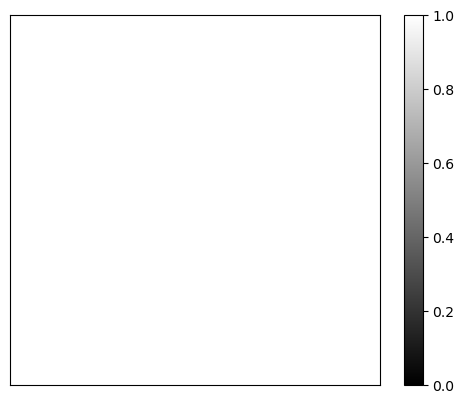

In [6]:
def create_update_map(height=32, width=32, L=5, device='cuda'):
    update_map = torch.ones(1, 1, height, width, 1, device=device)

    # Left-bottom triangle
    for i in range(L):
        for j in range(i + 1):  
            update_map[0, 0, height - L + i, j, 0] = 0

    # Right-bottom triangle
    for i in range(L):
        for j in range(i + 1):
            update_map[0, 0, height - L + i, width - 1 - j, 0] = 0

    return update_map
    
# update_map = create_update_map(height=32, width=32, L=12, device='cuda')
W = 8
update_map = torch.ones(1, 1, 32, 32, 1).to(device)
# update_map[:, :, :, :W,:] = 0
# update_map[:, :, :,-W:,:] = 0
print(update_map.shape)

plt.imshow(update_map.detach().cpu().numpy().squeeze(), cmap='gray', vmin=0, vmax=1)
plt.colorbar()
plt.xticks([]), plt.yticks([])
plt.show()

# Stage 1

## Run

In [ ]:
opt_config = copy.deepcopy(base_opt_config)

z0 = 0.01*torch.ones((1, 1, 32, 32, 1)).to(device)

optimizer_stage1 = multi_level_single_stage_optimization(
    config_stage1, z0, dir_to_results, data_loader, predictor, autoencoder, device, opt_config, update_map)


Measurement setup
 vertical_interval: 8,
         horizontal_interval: 32,
         marginal: 16,
 hard_data_locations: [], 
 steps: [1, 3]

🔵 Running Optimization for Level S1L1 ...
| niter |f evals|CG iter|  obj func   |tr radius |   opt    |  c viol  |
|-------|-------|-------|-------------|----------|----------|----------|
|   1   |   1   |   0   | +1.0719e+00 | 1.00e+00 | 1.94e-04 | 0.00e+00 |

`gtol` termination condition is satisfied.
Number of iterations: 1, function evaluations: 1, CG iterations: 0, optimality: 1.94e-04, constraint violation: 0.00e+00, execution time: 0.002 s.
Measurement setup
 vertical_interval: 8,
         horizontal_interval: 32,
         marginal: 16,
 hard_data_locations: [], 
 steps: [1, 3]
torch.Size([1, 1])
Stage 1: x1m0_tensor.shape = torch.Size([1, 1]), z1m0.shape = torch.Size([1, 1, 32, 32, 1])
Multi-resolution shapes: [torch.Size([1, 1, 32, 32, 1]), torch.Size([1, 1, 16, 16, 1]), torch.Size([1, 1, 8, 8, 1]), torch.Size([1, 1, 4, 4, 1]), torch.Size

## Plot

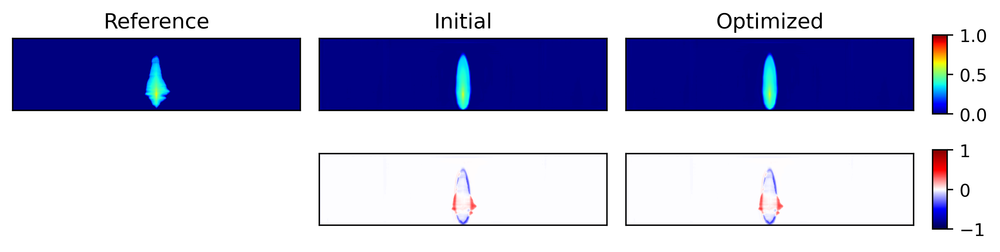

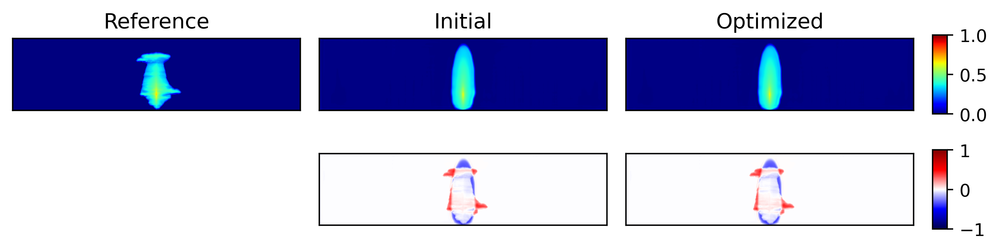

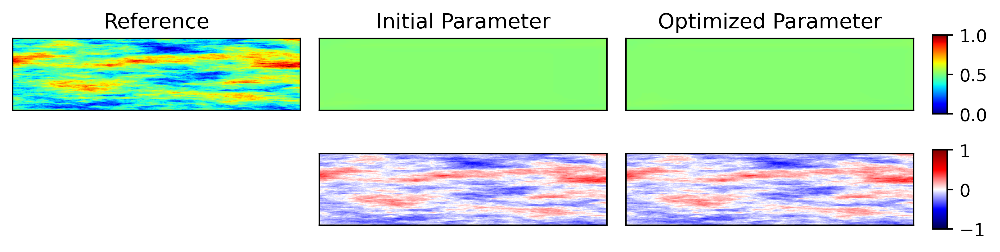

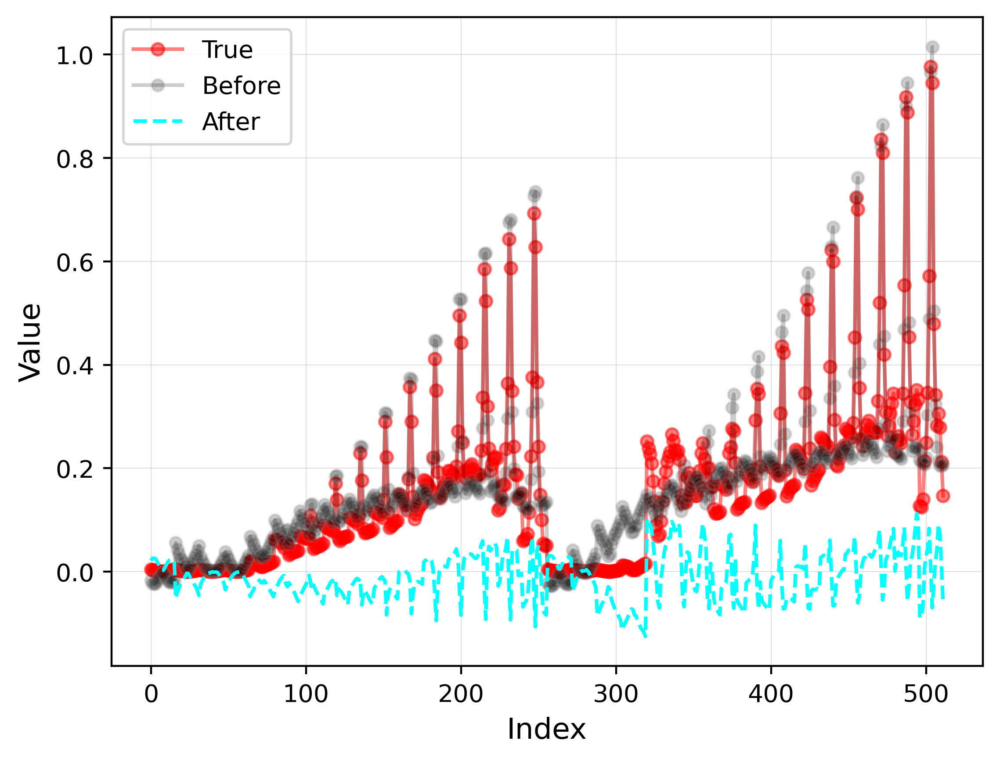

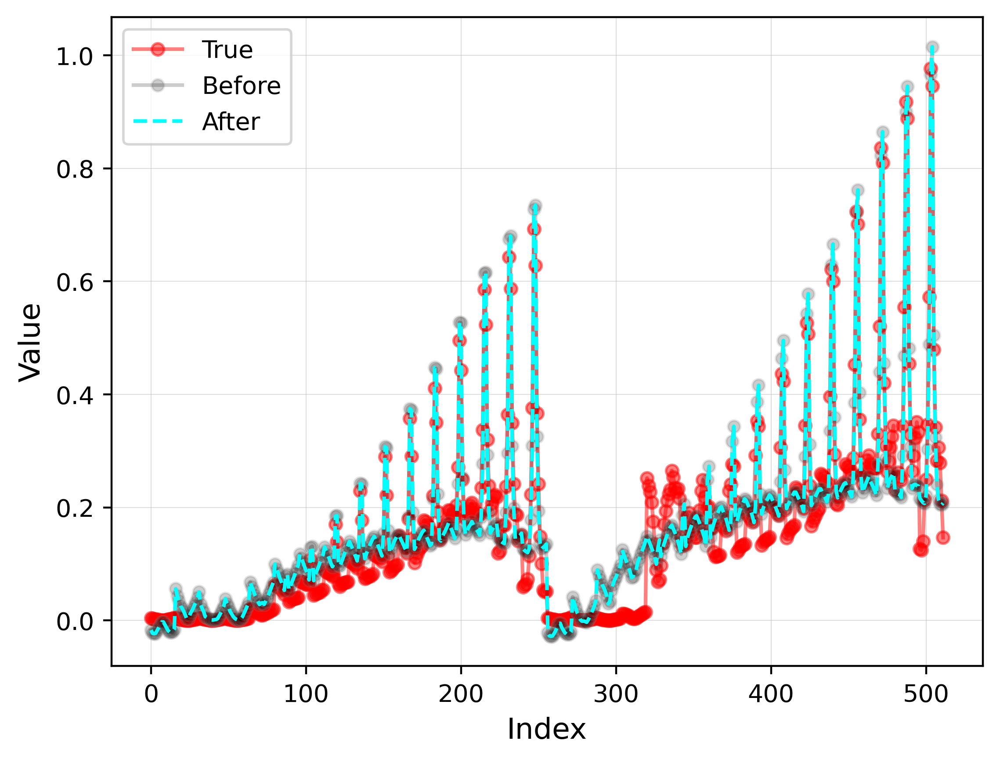

...

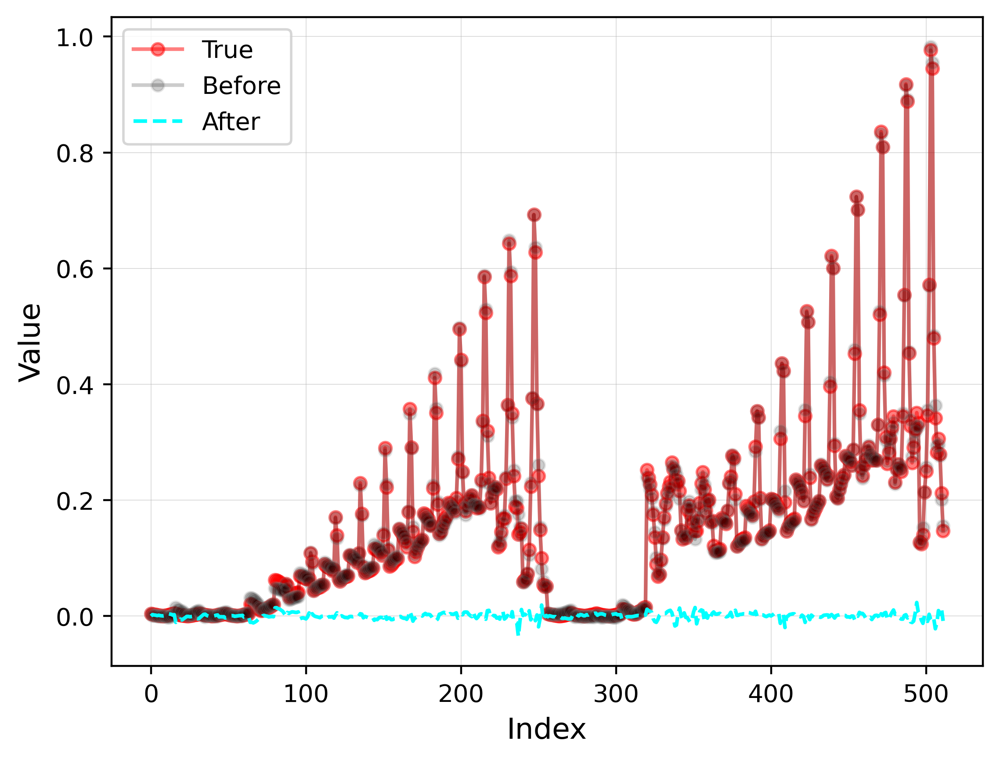

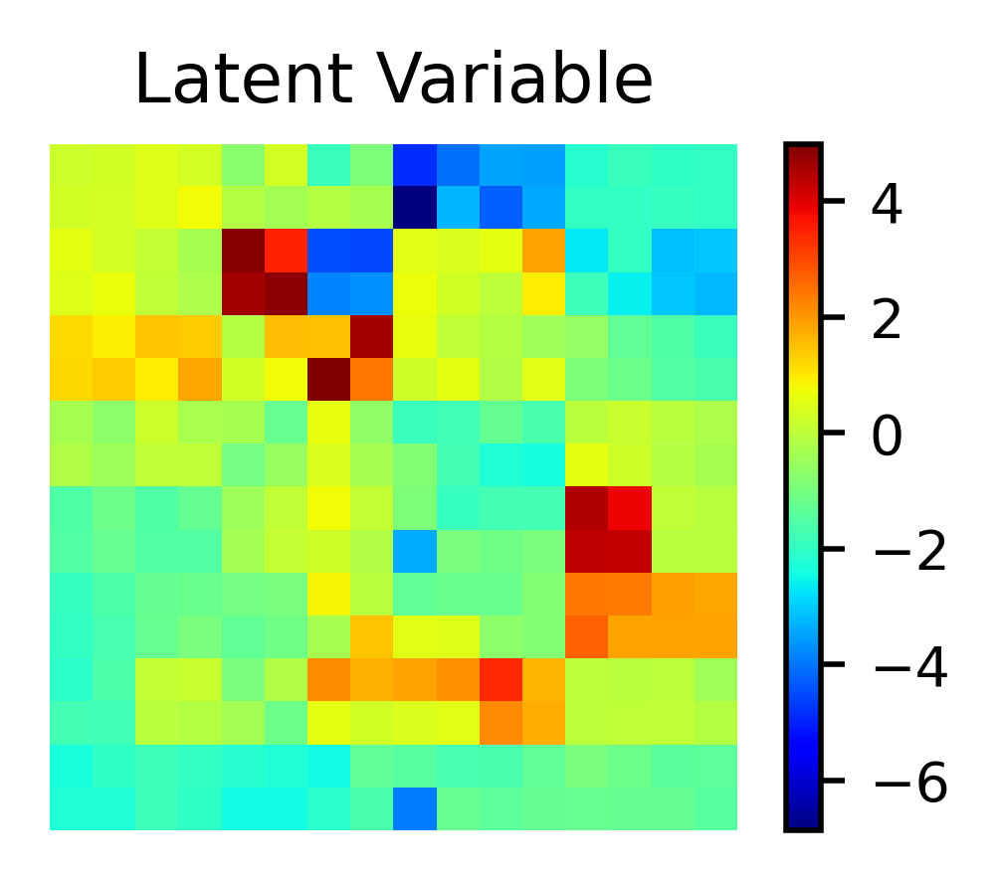

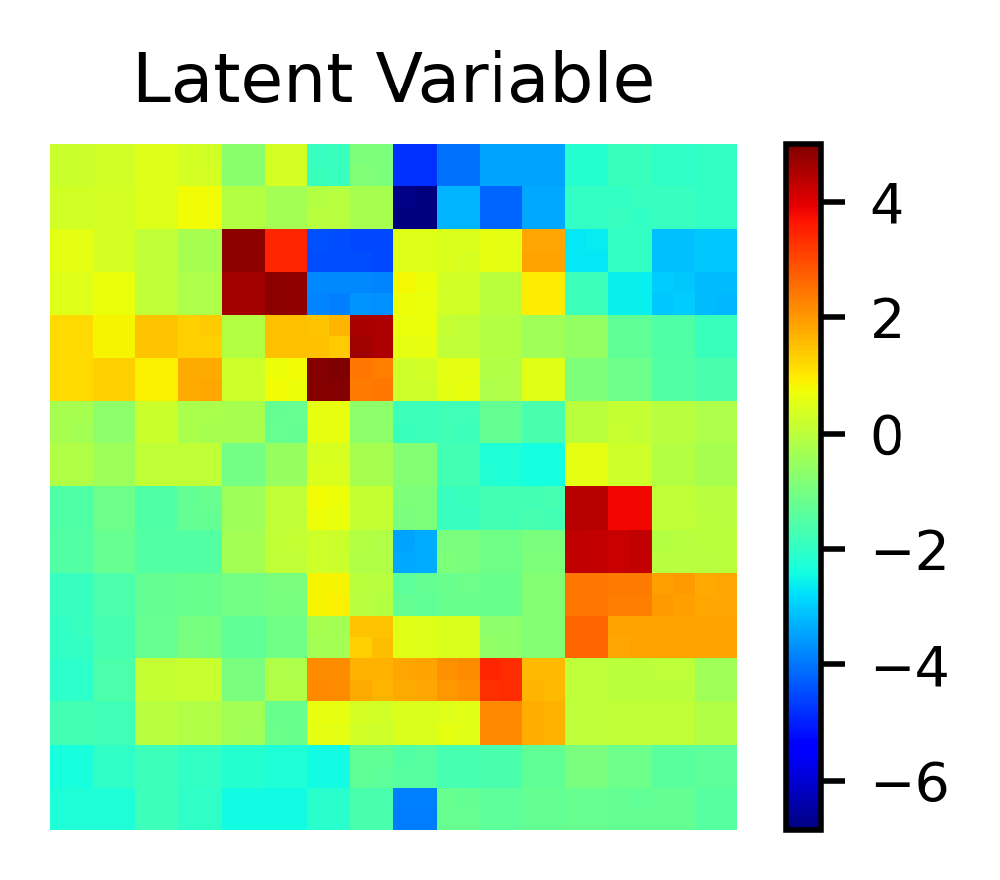

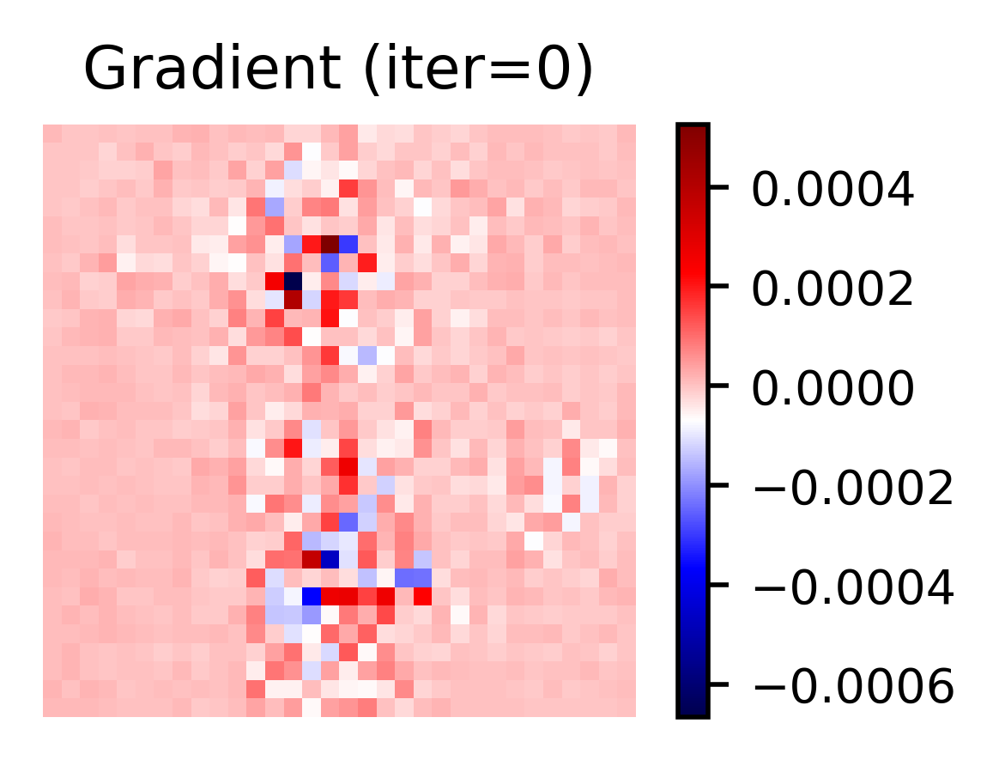

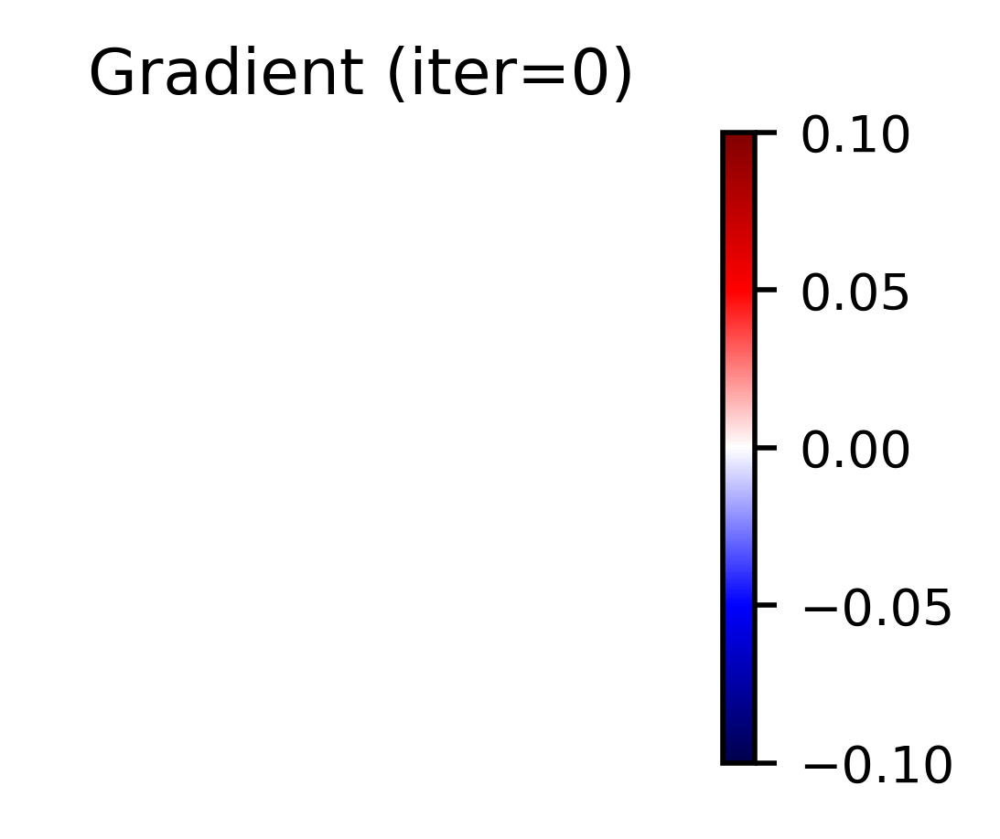

In [10]:
for config_name in config_stage1.keys():
    curr_config = config_stage1[config_name]
    curr_stage = optimizer_stage1[config_name]
    
    # Plot plume mismatch
    s_ref = curr_stage.s_ref
    s_all = np.load(join(dir_to_results, config_name, "s.npy"))[[0, -1], ...]
    s_obs = s_all[:, curr_config['Basic setup']['steps']]
    s_all.shape, s_obs.shape
    titles = ["Reference", "Initial", "Optimized"]
    for t in range(len(curr_config['Basic setup']['steps'])):
        plot_plume(s_ref = s_ref[:, t].squeeze(), 
                   s_ini = s_obs[0, t].squeeze(), 
                   s_opt = s_obs[-1,t].squeeze(),
                   titles = titles
                  )
    
    
    # Plot realization mismatch
    plot_real(curr_stage)
    
    
    # Plot data mismatch
    plot_obs(curr_stage.d_obs.T, curr_stage.sim_history['d'][0].T,  curr_stage.d_obs.T - curr_stage.sim_history['d'][0].T)
    plot_obs(curr_stage.d_obs.T, curr_stage.sim_history['d'][0].T,  curr_stage.sim_history['d'][-1].T)
    plot_obs(curr_stage.d_obs.T, curr_stage.sim_history['d'][-1].T, curr_stage.d_obs.T - curr_stage.sim_history['d'][-1].T)
    
    
    # Plot latent space
    figsize=(2., 2.)
    img = curr_stage.sim_history['z'][0].squeeze(0).squeeze(0)[..., 0]
    plot_map(img, figsize=figsize, cmap='jet', title='Latent Variable')
    
    img = curr_stage.sim_history['z'][-1].squeeze(0).squeeze(0)[..., 0]
    plot_map(img, figsize=figsize, cmap='jet', title='Latent Variable')
    
    g3d = copy.deepcopy(curr_stage.opt_history['gradients_3D'][0].squeeze())
    plot_map(g3d, figsize=figsize, cmap='seismic', title='Gradient (iter=0)')
    
    g3d[np.abs(g3d)<=0.4] = math.nan
    plot_map(g3d, figsize=figsize, cmap='seismic', title='Gradient (iter=0)')


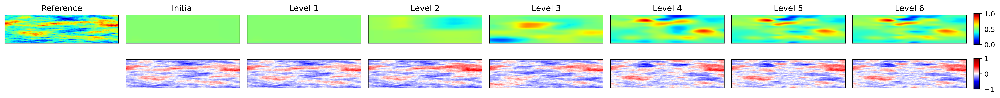

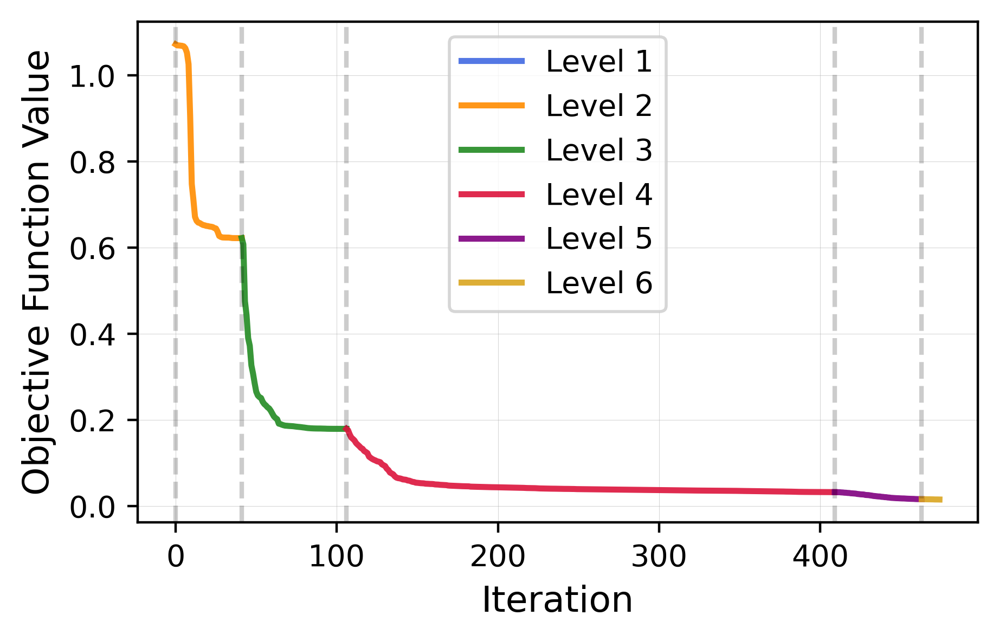

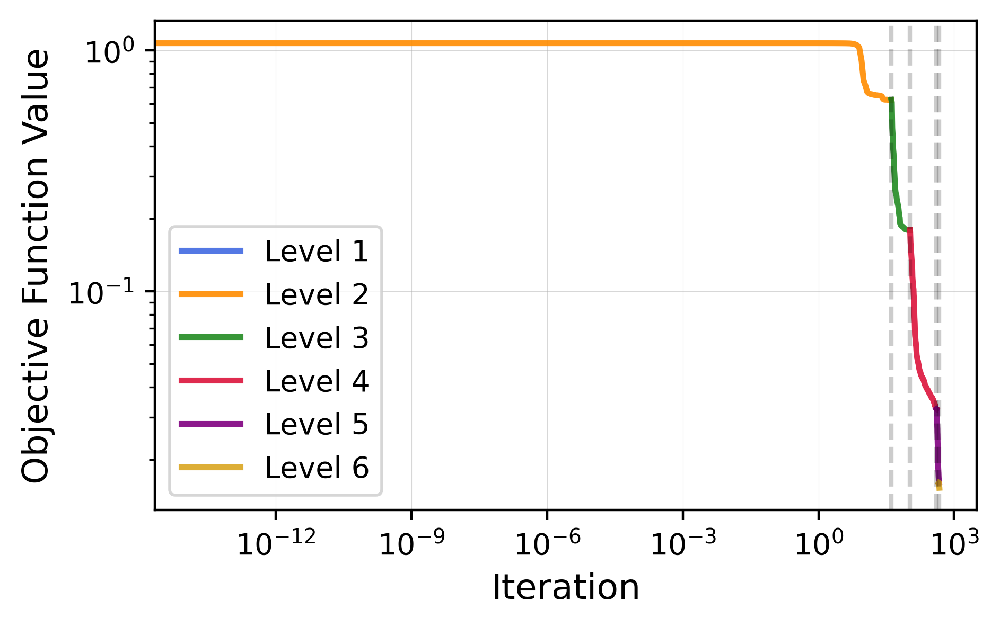

In [11]:
optimizer_dict = {}
fval_opts_dict = {}

for idx, opt in enumerate(optimizer_stage1.values()):
    optimizer_dict[f"Level {idx+1}"] = opt
    fval_opts_dict[f"Level {idx+1}"] = filter_non_decreasing(opt.sim_history['f'])
    
m_ref = next(iter(optimizer_stage1.values())).m_ref.squeeze()
plot_real2(optimizer_dict, m_ref, dpi=400)

plot_fval2(fval_opts_dict, logy_scale=False, dpi=400)
plot_fval2(fval_opts_dict, logy_scale=True, dpi=400)
